# set environment

In [20]:
### import libraries
suppressMessages(suppressWarnings(library(tidyverse)))
suppressMessages(suppressWarnings(library(MPSK)))
suppressMessages(suppressWarnings(library(parallelDist)))
suppressMessages(suppressWarnings(library(transport)))

suppressMessages(suppressWarnings(library(RColorBrewer)))
suppressMessages(suppressWarnings(library(gridExtra)))

suppressMessages(suppressWarnings(library(IRdisplay)))

### set directories
dat_dir = "/data/clintko/SMPK"

# get data

filenames

In [3]:
### get the names and numer of prior
fnames = grep("ep8cs_tsne_cal*", dir(dat_dir), value = TRUE)
priors = str_extract(fnames, "([0-9][0-9])")

### check the results
tmp = mapply(function(fn, pr){c(fn, pr)}, fnames, priors)
tmp = t(tmp)
display(tmp)

ep8cs_tsne_cal_prior05.txt,ep8cs_tsne_cal_prior05.txt,05
ep8cs_tsne_cal_prior06.txt,ep8cs_tsne_cal_prior06.txt,06
ep8cs_tsne_cal_prior07.txt,ep8cs_tsne_cal_prior07.txt,07
ep8cs_tsne_cal_prior08.txt,ep8cs_tsne_cal_prior08.txt,08
ep8cs_tsne_cal_prior09.txt,ep8cs_tsne_cal_prior09.txt,09
ep8cs_tsne_cal_prior10.txt,ep8cs_tsne_cal_prior10.txt,10
ep8cs_tsne_cal_prior11.txt,ep8cs_tsne_cal_prior11.txt,11
ep8cs_tsne_cal_prior12.txt,ep8cs_tsne_cal_prior12.txt,12
ep8cs_tsne_cal_prior13.txt,ep8cs_tsne_cal_prior13.txt,13
ep8cs_tsne_cal_prior14.txt,ep8cs_tsne_cal_prior14.txt,14
ep8cs_tsne_cal_prior15.txt,ep8cs_tsne_cal_prior15.txt,15


read in data

In [4]:
### read in raw file
tsne_mpsk_raw = read_delim(file.path(dat_dir, "ep8cs_tsne_raw.txt"), delim = "\t", col_names = FALSE)
colnames(tsne_mpsk_raw) = c("sample", "tsne1", "tsne2")

### made sample label into two digit
tsne_mpsk_raw$sample = str_pad(tsne_mpsk_raw$sample, 2, pad="0")

### read in MPSK calibrated file
tsne_mpsk_cal = lapply(fnames, function(fn){
    dat = suppressMessages(read_delim(file.path(dat_dir, fn),  delim = "\t", col_names = FALSE))
    colnames(dat) = c("sample", "cluster", "tsne1", "tsne2")
    dat$sample  = str_pad(dat$sample,  2, pad="0")
    dat$cluster = str_pad(dat$cluster, 2, pad="0")
    return(dat)
}) # end lapply

### modify the pior number
names(tsne_mpsk_cal) = paste0("prior", priors)

Parsed with column specification:
cols(
  X1 = col_double(),
  X2 = col_double(),
  X3 = col_double()
)


In [12]:
y_raw = tsne_mpsk_raw
y_cal = tsne_mpsk_cal$prior05

mat11 = y_raw %>% filter(sample == "01") %>% select(tsne1, tsne2)
mat12 = y_raw %>% filter(sample == "02") %>% select(tsne1, tsne2)

mat21 = y_cal %>% filter(sample == "01") %>% select(tsne1, tsne2)
mat22 = y_cal %>% filter(sample == "02") %>% select(tsne1, tsne2)

display(head(mat11, 3))
display(head(mat12, 3))
display(head(mat21, 3))
display(head(mat22, 3))

tsne1,tsne2
-18.683454,5.300567
18.398529,6.118176
-3.461957,13.952374


tsne1,tsne2
10.740033,-15.140380
-2.968976,4.073344
-9.825284,3.050411


tsne1,tsne2
-17.88750,4.354687
14.68341,5.222981
-5.04752,15.896918


tsne1,tsne2
8.794926,-16.476298
-14.106106,12.117753
-6.317664,-3.278776


# calculate conditional prob and KL

In [28]:
get_cond_prob = function(D, sigma2 = 1){
    P = exp(-1/2 * D^2 / sigma2)
    P = sweep(P, 2, colSums(P) - 1, `/`)
    P = P + t(P)   
    P = P / (2 * nrow(D)) # N = nrow(D) = ncol(D)
    return(P)
} # end func

get_KL = function(P, Q){
    kl = sum(P * (log(P) - log(Q)))
    return(kl)
} # end func

get_KL_dist = function(P, Q){
    kl_dist = get_KL(P, Q) + get_KL(Q, P)
    return(kl_dist)
} # end func

get_ws_dist = function(P, Q){
    ws_dist = wasserstein1d(as.vector(P), as.vector(Q))
    return(ws_dist)
} # end func

In [14]:
display(dim(mat11))
display(dim(mat12))
display(dim(mat21))
display(dim(mat22))

[1] 10000     2

[1] 10000     2

[1] 10000     2

[1] 10000     2

In [49]:
pt1 = c(-18.68345, 5.300567)
pt2 = c(18.39853,6.118176)
exp(-0.5 * sum((pt1 - pt2)^2) * 0.01)

[1] 0.001029473

In [39]:
mat = mat11[1:2,]
D   = mat %>% as.matrix %>% parDist %>% as.matrix
display(mat)
display(D)

tsne1,tsne2
-18.68345,5.300567
18.39853,6.118176


,1,2
1,0.000,37.091
2,37.091,0.000


In [37]:
mat = mat11[1:10,]
D11 = mat %>% as.matrix %>% parDist %>% as.matrix

#P11 = get_cond_prob(D11)
sigma2 = 1
P = exp(-1/2 * D11^2 / sigma2)
#P = sweep(P, 2, colSums(P) - 1, `/`)
#P = P + t(P)   
#P = P / (2 * nrow(D)) # N = nrow(D) = ncol(D)
P

,1,2,3,4,5,6,7,8,9,10
1,1.000000e+00,1.825735e-299,2.716498e-67,1.619892e-01,2.718391e-12,1.900702e-47,2.813862e-11,1.732357e-51,2.801273e-216,6.828868e-171
2,1.825735e-299,1.000000e+00,7.982684e-118,2.248520e-274,8.767168e-194,3.639672e-129,2.568201e-198,3.971470e-234,3.651315e-33,1.133328e-63
3,2.716498e-67,7.982684e-118,1.000000e+00,1.291119e-53,3.151263e-28,8.372919e-45,7.095111e-29,1.640105e-118,2.166865e-118,8.116076e-113
4,1.619892e-01,2.248520e-274,1.291119e-53,1.000000e+00,9.132792e-08,1.979270e-41,6.527844e-07,2.823157e-53,1.282659e-200,1.520846e-159
5,2.718391e-12,8.767168e-194,3.151263e-28,9.132792e-08,1.000000e+00,9.102087e-18,9.276139e-01,2.174587e-43,1.416947e-135,1.301021e-105
6,1.900702e-47,3.639672e-129,8.372919e-45,1.979270e-41,9.102087e-18,1.000000e+00,3.241049e-19,4.550965e-22,4.688054e-63,1.866823e-39
7,2.813862e-11,2.568201e-198,7.095111e-29,6.527844e-07,9.276139e-01,3.241049e-19,1.000000e+00,1.708013e-44,8.463093e-140,2.617936e-109
8,1.732357e-51,3.971470e-234,1.640105e-118,2.823157e-53,2.174587e-43,4.550965e-22,1.708013e-44,1.000000e+00,1.768575e-115,2.105833e-71
9,2.801273e-216,3.651315e-33,2.166865e-118,1.282659e-200,1.416947e-135,4.688054e-63,8.463093e-140,1.768575e-115,1.000000e+00,1.087697e-06
10,6.828868e-171,1.133328e-63,8.116076e-113,1.520846e-159,1.301021e-105,1.866823e-39,2.617936e-109,2.105833e-71,1.087697e-06,1.000000e+00


In [18]:

mat = mat12
D12 = mat %>% as.matrix %>% parDist %>% as.matrix
P12 = get_cond_prob(D12)

mat = mat21
D21 = mat %>% as.matrix %>% parDist %>% as.matrix
P21 = get_cond_prob(D21)

mat = mat22
D22 = mat %>% as.matrix %>% parDist %>% as.matrix
P22 = get_cond_prob(D22)

In [24]:
P = P11; Q = P11
print(get_KL(P, Q))
print(get_KL(Q, P))

[1] NaN
[1] NaN


In [25]:
P = P11; Q = P21
print(get_KL(P, Q))
print(get_KL(Q, P))

[1] NaN
[1] NaN


In [26]:
P = P11; Q = P21
print(get_KL_dist(P, Q))

[1] NaN


In [27]:
P = P11; Q = P21
print(get_ws_dist(P, Q))

[1] 4.546332e-09


In [ ]:
P = P11; Q = P21

In [20]:
print(tsne_mpsk_cal[["prior05"]]$cluster %>% unique)
head( tsne_mpsk_cal[["prior05"]])

[1] "03" "05" "04" "01" "02"


sample,cluster,tsne1,tsne2
01,03,-17.887501,4.3546872
01,05,14.683408,5.2229806
01,04,-5.047520,15.8969178
01,03,-19.548543,5.6870374
01,03,-12.300324,0.6647711
01,03,-4.503309,1.5016208


In [62]:
print(tsne_mpsk_cal[["prior50"]]$cluster %>% unique)
head( tsne_mpsk_cal[["prior50"]])

 [1] "33" "21" "18" "08" "29" "19" "25" "22" "49" "26" "46" "47" "42" "07" "17"
[16] "34" "23" "03" "20" "14" "01" "10" "37" "38" "43" "32" "39" "05" "06" "30"
[31] "24" "13" "16" "28" "12" "04" "15" "02" "45" "36" "27" "09" "11" "48" "41"
[46] "40" "50"


sample,cluster,tsne1,tsne2
01,33,-18.683454,5.3005673
01,21,18.398529,6.1181760
01,18,-3.461957,13.9523745
01,33,-17.099855,6.3648347
01,08,-11.418336,5.9934045
01,29,-5.086351,-0.2019182


In [48]:
idx = 1
prior = names(tsne_mpsk_cal)[[idx]]
print(prior)
print(tsne_mpsk_cal[[prior]]$cluster %>% unique)
head( tsne_mpsk_cal[[prior]])

[1] "prior05"
[1] 3 5 4 1 2


sample,cluster,tsne1,tsne2
01,3,-17.887501,4.3546872
01,5,14.683408,5.2229806
01,4,-5.047520,15.8969178
01,3,-19.548543,5.6870374
01,3,-12.300324,0.6647711
01,3,-4.503309,1.5016208


# plot

In [127]:
gp_theme = theme(
    #legend.title = element_text(size = 15, face = "bold"),
    #legend.text  = element_text(size = 10, face = "bold"),
    legend.position = "none",
    strip.text   = element_text(size = 10, face = "bold"),
    axis.title   = element_text(size = 15, face = "bold"))

In [128]:
dat = tsne_mpsk_raw %>% filter(sample %in% c("01", "02", "03", "04"))
dat$prep    = "Scaled Raw Data"
dat$cluster = "00"

lst = lapply(1:length(tsne_mpsk_cal), function(idx){
    ### get the prior number
    prior = names(tsne_mpsk_cal)[[idx]]
    ### get the tsne results
    dat = tsne_mpsk_cal[[prior]]
    dat = dat %>% filter(sample %in% c("01", "02", "03", "04"))
    dat$prep = paste("Calibration:", prior)
    return(dat)
})

In [129]:
tmp = do.call(bind_rows, lst)
tmp = bind_rows(dat, tmp)
tmp$prep = factor(tmp$prep, levels = c(paste("Calibration:", names(tsne_mpsk_cal)),"Scaled Raw Data"))

In [130]:
gp = tmp %>% ggplot(., aes(x = tsne1, y = tsne2, color = cluster)) + 
    geom_point(size = 0.1, alpha = 0.5) + 
    facet_grid(prep~sample) + 
    theme_bw() +
    labs(x = "Dim 1", y = "Dim 2") +
    #guides(colour = guide_legend(override.aes = list(size=2))) +
    gp_theme

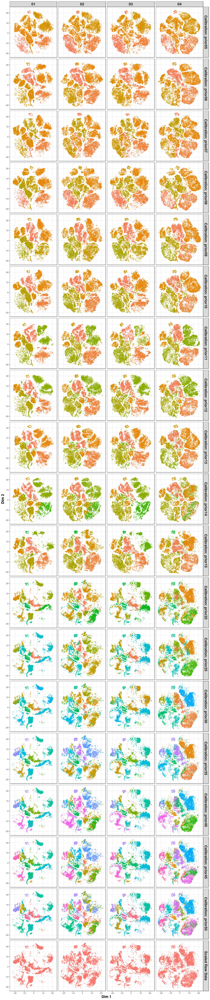

In [118]:
options(repr.plot.width = 3 * 4, repr.plot.height = 3 * (length(lst) + 1))
print(gp)

In [ ]:
ggsave("MPSK_compare_diff_prior.png", gp, device = "png", 
       dpi = 300, width = 5 * 4, height = 5 * (length(lst) + 1), 
       units = "cm")

In [90]:
dat = tsne_mpsk_raw %>% filter(sample %in% c("01", "02", "03", "04"))

gp_raw = dat %>% ggplot(., aes(x = tsne1, y = tsne2)) + 
    geom_point(size = 0.5, alpha = 0.5) + 
    facet_wrap(~sample, nrow = 1) + 
    theme_bw() +
    labs(x = "Dim 1", y = "Dim 2", title = "Scaled Raw Data") +
    guides(colour = guide_legend(override.aes = list(size=2))) +
    gp_theme

In [93]:
gp_cal = lapply(1:length(tsne_mpsk_cal), function(idx){
    ###
    prior = names(tsne_mpsk_cal)[[idx]]
    ###
    dat = tsne_mpsk_cal[[prior]]
    dat = dat %>% filter(sample %in% c("01", "02", "03", "04"))
    
    ###
    gp = dat %>% ggplot(., aes(x = tsne1, y = tsne2, color = cluster)) + 
        geom_point(size = 0.5, alpha = 0.2) + 
        facet_wrap(~sample, nrow = 1) + 
        theme_bw() +
        labs(x = "Dim 1", y = "Dim 2", title = paste("Calibration:", prior)) +
        guides(colour = guide_legend(override.aes = list(size=2))) +
        gp_theme
             
    return(gp)
})

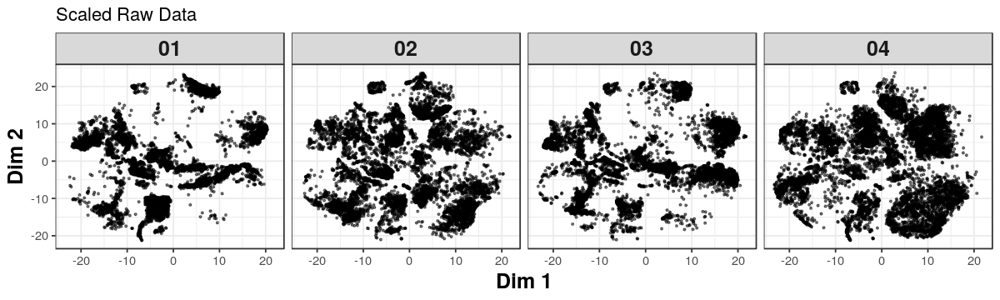

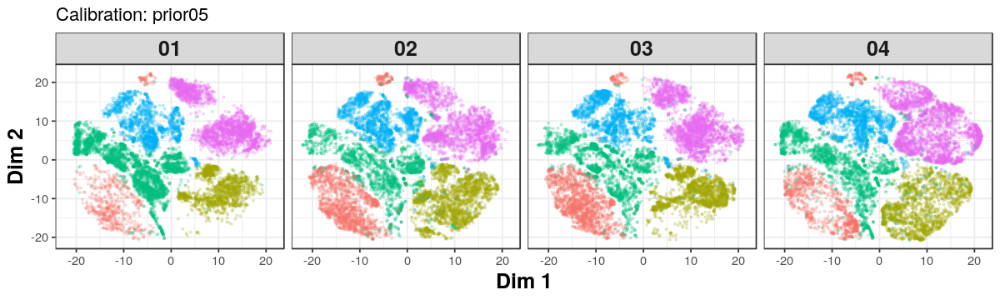

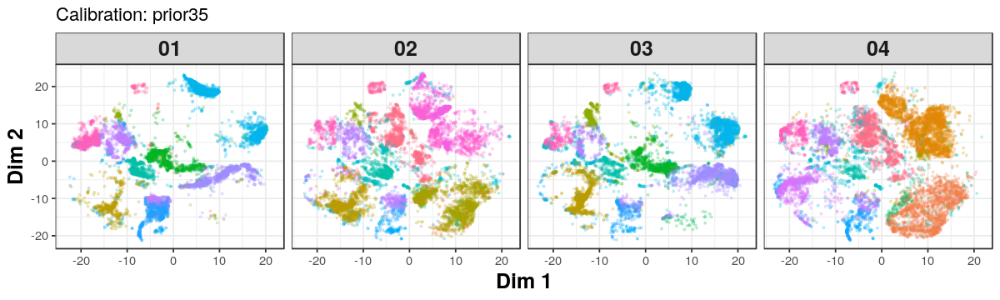

In [95]:
options(repr.plot.width = 10, repr.plot.height = 3)
print(gp_raw)
print(gp_cal[[1]])
print(gp_cal[[15]])

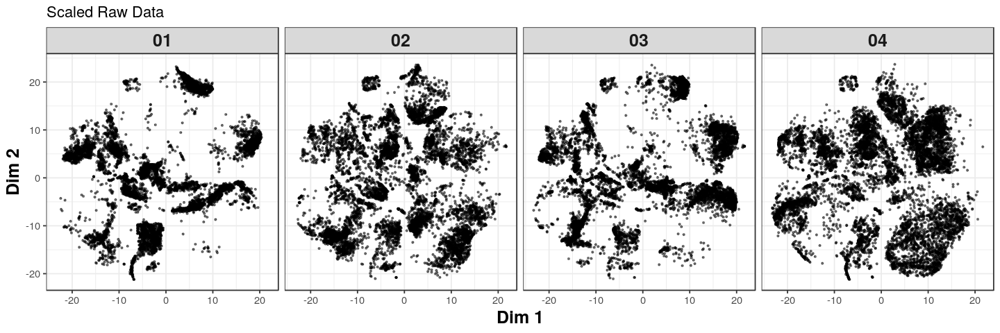

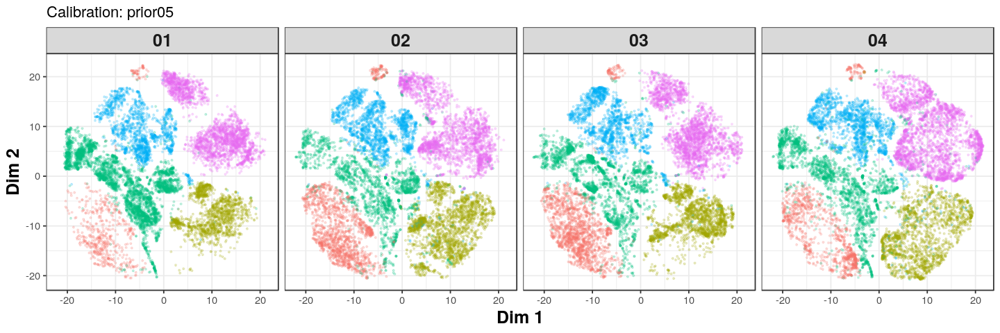

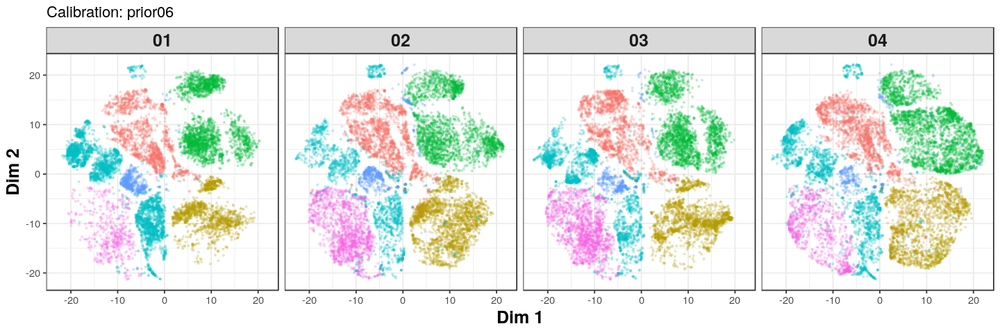

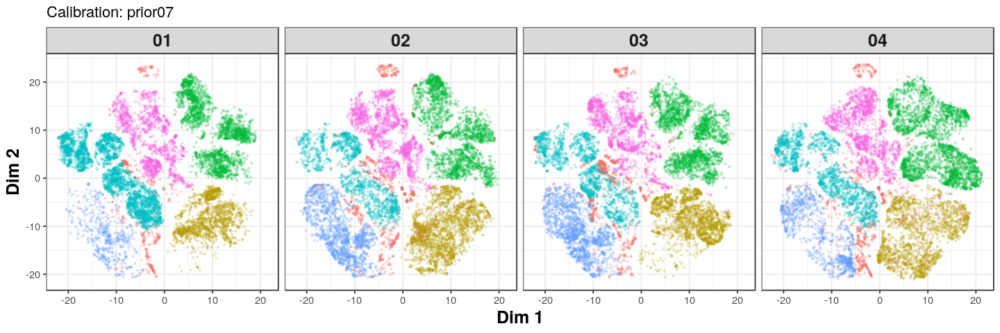

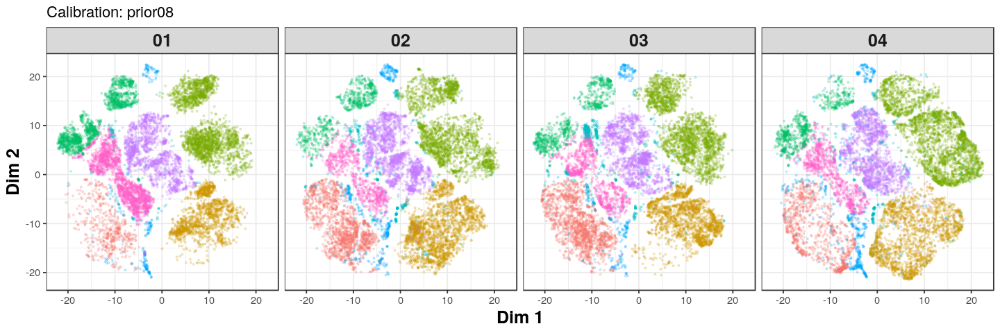

...

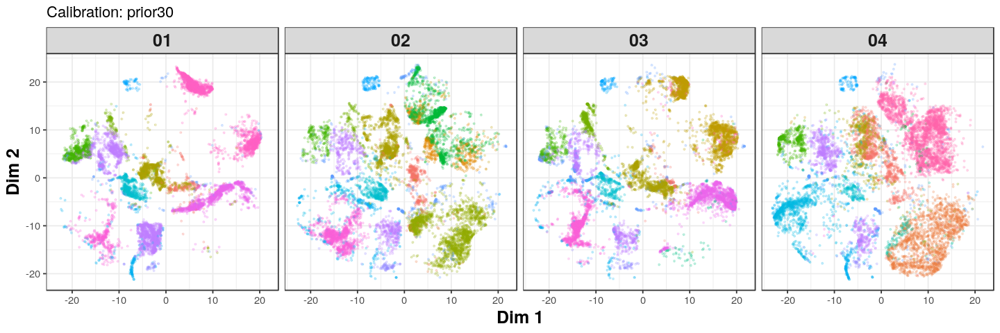

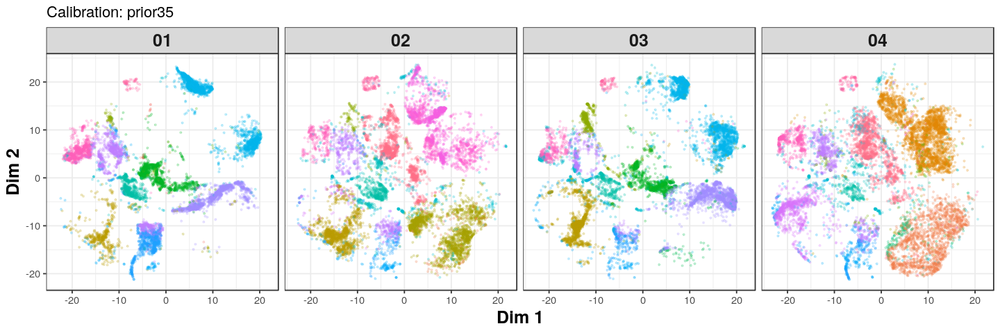

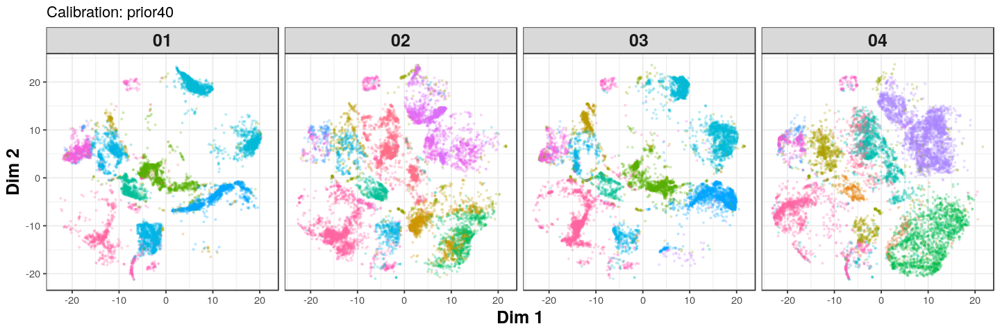

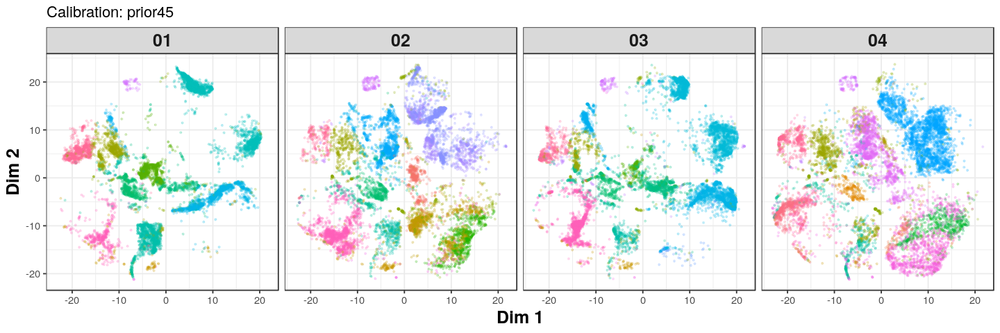

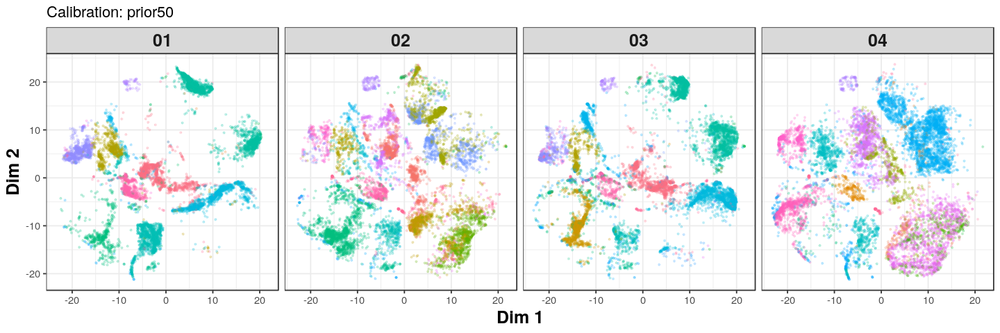

In [96]:
options(repr.plot.width = 12, repr.plot.height = 4)
print(gp_raw)
for(gp in gp_cal){print(gp)}

In [26]:
dat = tsne_mpsk_cal_p05

gp = dat %>% ggplot(., aes(x = tsne1, y = tsne2)) + 
    geom_point(size = 0.5, alpha = 0.5) + 
    facet_wrap(~sample) + 
    theme_bw() +
    labs(x = "Dim 1", y = "Dim 2", title = "Scaled Raw Data") +
    guides(colour = guide_legend(override.aes = list(size=2))) +
    gp_theme

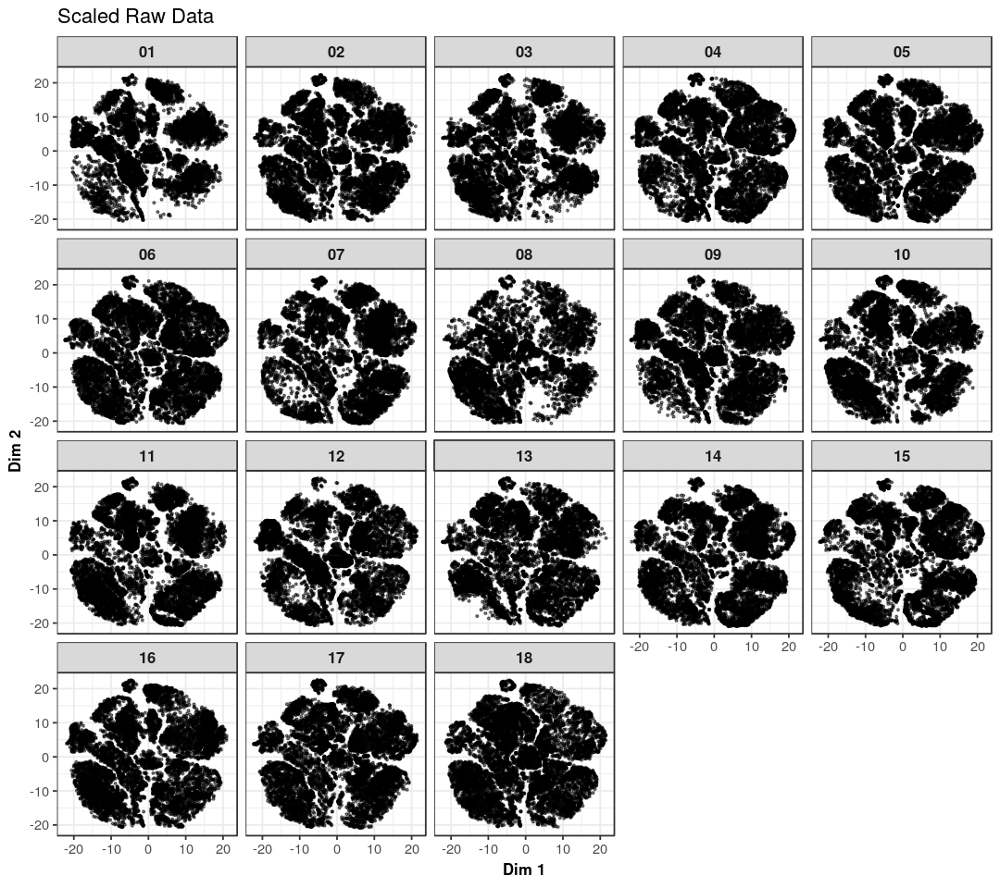

In [27]:
options(repr.plot.width = 9, repr.plot.height = 8)
print(gp)